In [1]:
# Librerías
import numpy as np
import deepxde as dde
import matplotlib.pyplot as plt
from scipy.interpolate import griddata
import deepxde.backend.tensorflow as tf

Using backend: tensorflow.compat.v1
Other supported backends: tensorflow, pytorch, jax, paddle.
paddle supports more examples now and is recommended.


Instructions for updating:
non-resource variables are not supported in the long term


In [ ]:
# Parámetros del problema.
L = 5           # Longitud de la barra.
Lscalado = 1.0  # Longitud escalada.
n_terms = 50    # Número de términos en la serie de Fourier.
D = 1.58        # Coeficiente de difusión térmica.
K = 0.8         # Coeficiente reactivo.
T_max = 1.0     # Tiempo máximo.
Kelvin = 273.15 # Conversión de Celsius a Kelvin.

In [3]:
# LaTeX.
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.size": 5,
    "axes.labelsize": 13,
    "axes.titlesize": 14,
    "xtick.labelsize": 13,
    "ytick.labelsize": 13,
    "legend.fontsize": 13,
    "axes.linewidth": 1.2,
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 6,
    "ytick.major.size": 6,
})

Se realizan pruebas de escalado y elección de hiperparámetros de una vanilla-PINN para luego construir sobre esta las demás variantes. Las pruebas se realizan sobre el primer problema.

# Solución analítica - Problema 1

In [ ]:
# Condición inicial.
def IC(x):
    return (50 * np.exp(-10 * (x - 2)**2)*(5-x)*x)  # Pico de 300 ºC en x=2.

# Cálculo de los coeficientes de Fourier Cn.
def coeficientesF(n_terms):
    C = np.zeros(n_terms)
    for n in range(1,n_terms):
        k_n = (n) * np.pi / (L)
        integrand = lambda x: (IC(x)) * np.sin(k_n * x)
        C[n] = (2 / L) * np.trapz(integrand(np.linspace(0, L, 10000)), np.linspace(0, L, 10000))
    return C

C_n = coeficientesF(n_terms)

# (Solución del primer problema).
def u_xt(M):
    solution = 0
    for n in range(1,n_terms):
        k_n = (n) * np.pi / (L)
        solution += C_n[n] * np.sin(k_n * M[:,0:1]) * np.exp((-D*(k_n**2)+K) * M[:,1:2])
    return solution.reshape(-1, 1)  # Salida sea un vector columna.

# Crear una malla combinando la primera columna (x) y la segunda columna (t) de M.
x_vals = np.linspace(0, L, 200)      # Valores de x (espacio).
t_vals = np.linspace(0, T_max, 200)  # Valores de t (tiempo).

# Crear una malla 2D con todas las combinaciones de x y t.
X, T = np.meshgrid(x_vals, t_vals)

# Aplanar las mallas para crear pares (x, t).
M_combined = np.column_stack([X.ravel(), T.ravel()])

# Evaluar la función para cada combinación de (x, t).
U = u_xt(M_combined)+Kelvin # Se convierte a Kelvin.

# Volver a dar forma a los resultados para que coincidan con la malla.
U = U.reshape(X.shape)

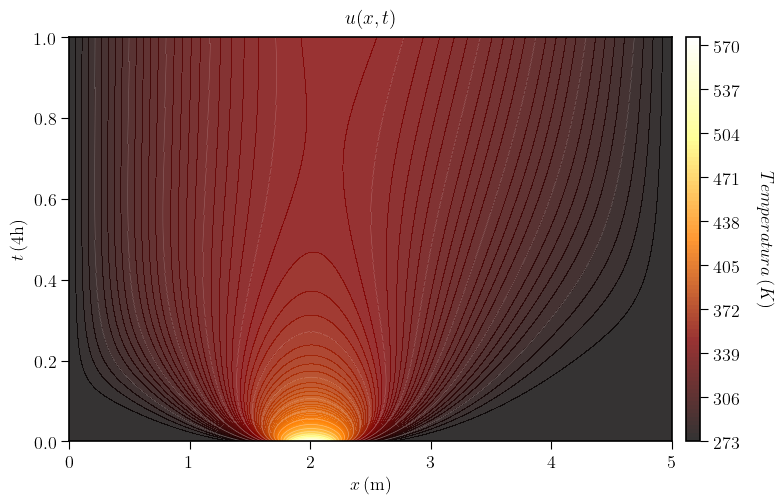

In [5]:
plt.figure(figsize=(8, 5))

contour = plt.contourf(X, T, U, levels=100, cmap='afmhot', alpha=0.8)

# Líneas de contorno.
contour_lines = plt.contour(X, T, U, levels=20, colors='white', linewidths=0.5, alpha=0.4)

cbar = plt.colorbar(contour, pad=0.02, aspect=30)
cbar.ax.tick_params(labelsize=13)
cbar.set_label(r"$Temperatura\, (K)$", rotation=-90, labelpad=25)

plt.title(r"$u(x, t)$", pad=10)
plt.xlabel(r"$x\,(\mathrm{m})$")
plt.ylabel(r"$t\,(\mathrm{4h})$")

plt.tight_layout()
plt.show()

# Vanilla-PINN

In [ ]:
# Funciones a llamar durante el entrenameinto de la PINN.

def ICreescaladox(x):
    y = x[:, 0:1] * L  # Reescalar x a la longitud de la barra.
    u = 50 * tf.exp(-10 * tf.square(y - 2)) * (5 - y) * y
    return u / F       # Pico de 300 ºC en x=2.

def EDPreescaladox(x, u):
    du_t = dde.grad.jacobian(u, x, i=0, j=1)
    du_xx = dde.grad.hessian(u, x, i=0, j=0)
    return du_t - (D/(L)**2)*du_xx - K*u  # Reescalar x a la longitud de la barra.

def u_xt1reescaladox(x):
    y = np.copy(x)      # Reescalar x a la longitud de la barra.
    y[:,0:1] = y[:,0:1]*L
    return u_xt(y) / F  # Escalar la solución.

# EDP: u_t = u_xx + u.
def EDPsinreescalarx(x, u):
    du_t = dde.grad.jacobian(u, x, i=0, j=1)
    du_xx = dde.grad.hessian(u, x, i=0, j=0)
    return du_t - (D)*du_xx - K*u

def u_xt1(x):
    return u_xt(x) / F  # Escalar la solución.

def IC(x):
    u = 50 * tf.exp(-10 * tf.square(x[:,0:1] - 2)) * (5 - x[:,0:1]) * x[:,0:1]
    return u / F        # Pico de 300 ºC en x=2.

### vanilla-PINN 1
Optimizador: Adam

Función de activación: tanh

Collocation points: 1500

Boundary points: 100

Initial points: 120

Nº de capas profundas: 2

Nº de neuronas: 16

lr = 0.01

Peso de la función error, todos 1.

In [7]:
F = 1  # Reescalado.

In [8]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [9]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

# Configurar PINN.
data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[1, 1, 1, 1])
# Entrenar el modelo.
losshistory1, train_state = model.train(iterations=20000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.021123 s

'compile' took 0.136534 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.05e-01, 7.13e-02, 3.83e-02, 7.13e+03]    [9.24e-02, 7.13e-02, 3.83e-02, 7.13e+03]    [2.74e+03]    
1         [4.48e-02, 1.34e-01, 1.22e-01, 7.10e+03]    [4.15e-02, 1.34e-01, 1.22e-01, 7.10e+03]    [2.71e+03]    
2         [2.06e-01, 2.21e-01, 7.32e-01, 7.07e+03]    [2.14e-01, 2.21e-01, 7.32e-01, 7.07e+03]    [2.68e+03]    
3         [5.67e-01, 3.38e-01, 1.83e+00, 7.04e+03]    [5.87e-01, 3.38e-01, 1.83e+00, 7.04e+03]    [2.64e+03]    
4         [1.10e+00, 4.85e-01, 3.36e+00, 7.02e+03]    [1.13e+00, 4.85e-01, 3.36e+00, 7.02e+03]    [2.61e+03]    
5         [1.79e+00, 6.66e-01, 5.26e+00, 6.99e+03]    [1.83e+00, 6.66e-01, 5.26e+00, 6.99e+03]    [2.58e+03]    
6         [2.59e+00, 8.87e-01, 7.43e+00, 6.97e+03]    [2.65e+00, 8.87e-01, 7.43

I0000 00:00:1750691620.918402   58938 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


13        [9.90e+00, 3.77e+00, 2.37e+01, 6.84e+03]    [9.94e+00, 3.77e+00, 2.37e+01, 6.84e+03]    [2.40e+03]    
14        [1.11e+01, 4.34e+00, 2.58e+01, 6.83e+03]    [1.11e+01, 4.34e+00, 2.58e+01, 6.83e+03]    [2.38e+03]    
15        [1.24e+01, 4.90e+00, 2.79e+01, 6.81e+03]    [1.23e+01, 4.90e+00, 2.79e+01, 6.81e+03]    [2.36e+03]    
16        [1.37e+01, 5.44e+00, 3.00e+01, 6.80e+03]    [1.36e+01, 5.44e+00, 3.00e+01, 6.80e+03]    [2.35e+03]    
17        [1.51e+01, 5.94e+00, 3.21e+01, 6.79e+03]    [1.49e+01, 5.94e+00, 3.21e+01, 6.79e+03]    [2.33e+03]    
18        [1.66e+01, 6.37e+00, 3.42e+01, 6.78e+03]    [1.63e+01, 6.37e+00, 3.42e+01, 6.78e+03]    [2.32e+03]    
19        [1.81e+01, 6.70e+00, 3.64e+01, 6.77e+03]    [1.77e+01, 6.70e+00, 3.64e+01, 6.77e+03]    [2.30e+03]    
20        [1.96e+01, 6.93e+00, 3.86e+01, 6.76e+03]    [1.92e+01, 6.93e+00, 3.86e+01, 6.76e+03]    [2.29e+03]    
21        [2.12e+01, 7.04e+00, 4.08e+01, 6.75e+03]    [2.07e+01, 7.04e+00, 4.08e+01, 6.75e+03]  

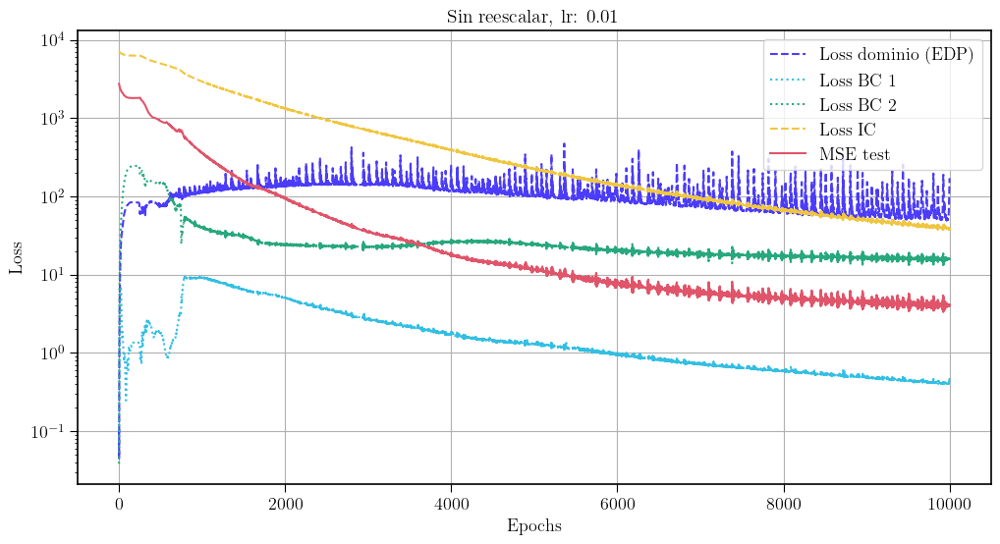

In [10]:
loss_train = np.array(losshistory1.loss_train)*F**2
testmetric134 = np.array(losshistory1.metrics_test)*F**2
testmetric1 = testmetric134[:10000, 0]  # MSE test.

colors = [
    "#4B3CFA",
    "#33BFE3", 
    "#28A87D", 
    "#F0C640", 
    "#E1556A", 
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:10000, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])
plt.plot(loss_train[:10000, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:10000, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:10000, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric1[:], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Sin reescalar, lr: 0.01")
plt.legend()
plt.grid(True)
plt.show()

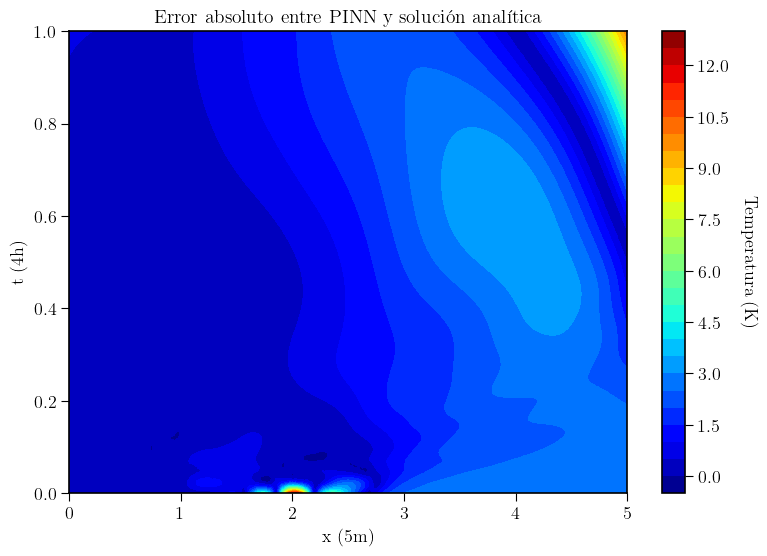

In [11]:
test_points = geomtime.uniform_points(10125, True) 
y_pred = model.predict(test_points)*F  # Reescalar la predicción.
y_true = u_xt(test_points)*F  # Reescalar la solución analítica.

# Error absoluto.
y_error = np.abs(y_pred - y_true) 

# Graficar el error en el dominio.
x_grid = np.linspace(0, L, 500)
t_grid = np.linspace(0, T_max, 500)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(test_points, y_error.flatten(), (X, T), method="cubic")

plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label("Temperatura (K)", rotation=-90, labelpad=20)

plt.xlabel("x (5m)")
plt.ylabel("t (4h)")
plt.title("Error absoluto entre PINN y solución analítica")
plt.show()

In [ ]:
# MSE.
mse = np.mean((y_pred - y_true)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 3.5043


Se va a probar la misma configuración de red pero ahora añadiendo más valores en la condición inicial y menos en el dominio.

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16]*2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[1, 1, 1, 1])
# Entrenar el modelo.
losshistory1, train_state = model.train(iterations=20000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.017155 s

'compile' took 0.234931 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.74e-01, 5.98e-02, 3.15e-02, 7.08e+03]    [9.24e-02, 5.98e-02, 3.15e-02, 7.08e+03]    [3.14e+03]    
1         [6.38e-02, 1.16e-01, 1.33e-01, 7.05e+03]    [4.15e-02, 1.16e-01, 1.33e-01, 7.05e+03]    [3.11e+03]    
2         [1.77e-01, 1.97e-01, 7.52e-01, 7.02e+03]    [2.14e-01, 1.97e-01, 7.52e-01, 7.02e+03]    [3.08e+03]    
3         [4.95e-01, 3.06e-01, 1.85e+00, 6.99e+03]    [5.86e-01, 3.06e-01, 1.85e+00, 6.99e+03]    [3.04e+03]    
4         [9.93e-01, 4.46e-01, 3.38e+00, 6.97e+03]    [1.13e+00, 4.46e-01, 3.38e+00, 6.97e+03]    [3.01e+03]    
5         [1.65e+00, 6.20e-01, 5.28e+00, 6.94e+03]    [1.83e+00, 6.20e-01, 5.28e+00, 6.94e+03]    [2.99e+03]    
6         [2.43e+00, 8.35e-01, 7.45e+00, 6.92e+03]    [2.65e+00, 8.35e-01, 7.45

Otra arquitectura igual pero añadiendo más puntos.

In [14]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution= u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[1, 1, 1, 1])
# Entrenar el modelo.
losshistory13, train_state = model.train(iterations=20000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.020482 s

'compile' took 0.142865 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.32e-01, 6.42e-02, 3.52e-02, 7.08e+03]    [9.24e-02, 6.42e-02, 3.52e-02, 7.08e+03]    [3.14e+03]    
1         [5.23e-02, 1.24e-01, 1.28e-01, 7.05e+03]    [4.15e-02, 1.24e-01, 1.28e-01, 7.05e+03]    [3.11e+03]    
2         [1.95e-01, 2.09e-01, 7.43e-01, 7.02e+03]    [2.14e-01, 2.09e-01, 7.43e-01, 7.02e+03]    [3.08e+03]    
3         [5.41e-01, 3.21e-01, 1.84e+00, 6.99e+03]    [5.87e-01, 3.21e-01, 1.84e+00, 6.99e+03]    [3.04e+03]    
4         [1.07e+00, 4.66e-01, 3.37e+00, 6.97e+03]    [1.13e+00, 4.66e-01, 3.37e+00, 6.97e+03]    [3.01e+03]    
5         [1.74e+00, 6.45e-01, 5.27e+00, 6.94e+03]    [1.83e+00, 6.45e-01, 5.27e+00, 6.94e+03]    [2.99e+03]    
6         [2.54e+00, 8.63e-01, 7.44e+00, 6.92e+03]    [2.65e+00, 8.63e-01, 7.44

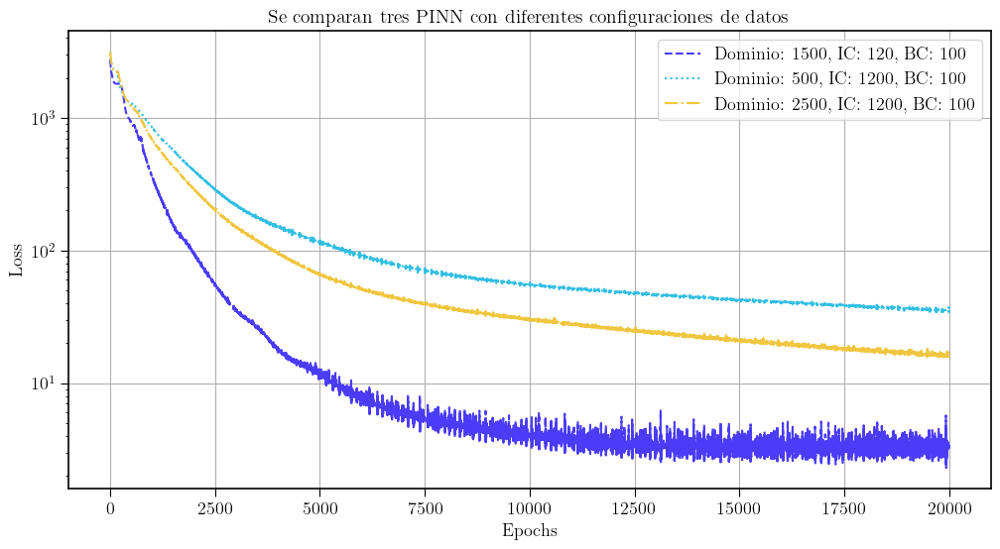

In [15]:
testmetric12 = np.array(losshistory1.metrics_test)*F**2
testmetric13 = np.array(losshistory13.metrics_test)*F**2

colors = [
    "#4B3CFA", 
    "#33BFE3", 
    "#28A87D", 
    "#F0C640",
    "#E1556A",
]



plt.figure(figsize=(12, 6))
plt.plot(testmetric134[:, 0], label="Dominio: 1500, IC: 120, BC: 100", linestyle='--', color=colors[0])
plt.plot(testmetric12[:, 0], label="Dominio: 500, IC: 1200, BC: 100", linestyle=':', color = colors[1])
plt.plot(testmetric13[:, 0], label="Dominio: 2500, IC: 1200, BC: 100", linestyle='-.', color = colors[3])


plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Se comparan tres PINN con diferentes configuraciones de datos")
plt.legend()
plt.grid(True)
plt.show()

Se encuentra un modelo un poco más complejo.

In [ ]:
F = 100 # Reescalado.

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Condición inicial u(x, 0) = f(x)
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    EDPreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution= u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1, 4])
# Entrenar el modelo.
model.train(iterations=20000,display_every=1)
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 4])
losshistory234, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.028883 s

'compile' took 0.208480 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.66e-03, 9.65e-04, 7.87e-03, 2.75e+00]    [1.97e-03, 9.65e-04, 7.87e-03, 2.75e+00]    [2.72e-01]    
1         [3.76e-02, 1.26e-03, 5.44e-02, 2.57e+00]    [4.15e-02, 1.26e-03, 5.44e-02, 2.57e+00]    [2.32e-01]    
2         [7.74e-02, 3.61e-03, 9.22e-02, 2.52e+00]    [8.27e-02, 3.61e-03, 9.22e-02, 2.52e+00]    [2.12e-01]    
3         [7.10e-02, 7.34e-03, 8.48e-02, 2.50e+00]    [7.69e-02, 7.34e-03, 8.48e-02, 2.50e+00]    [2.05e-01]    
4         [4.68e-02, 1.17e-02, 5.91e-02, 2.50e+00]    [5.25e-02, 1.17e-02, 5.91e-02, 2.50e+00]    [2.06e-01]    
5         [2.57e-02, 1.62e-02, 3.32e-02, 2.51e+00]    [3.03e-02, 1.62e-02, 3.32e-02, 2.51e+00]    [2.11e-01]    
6         [1.52e-02, 2.07e-02, 1.61e-02, 2.53e+00]    [1.85e-02, 2.07e-02, 1.61

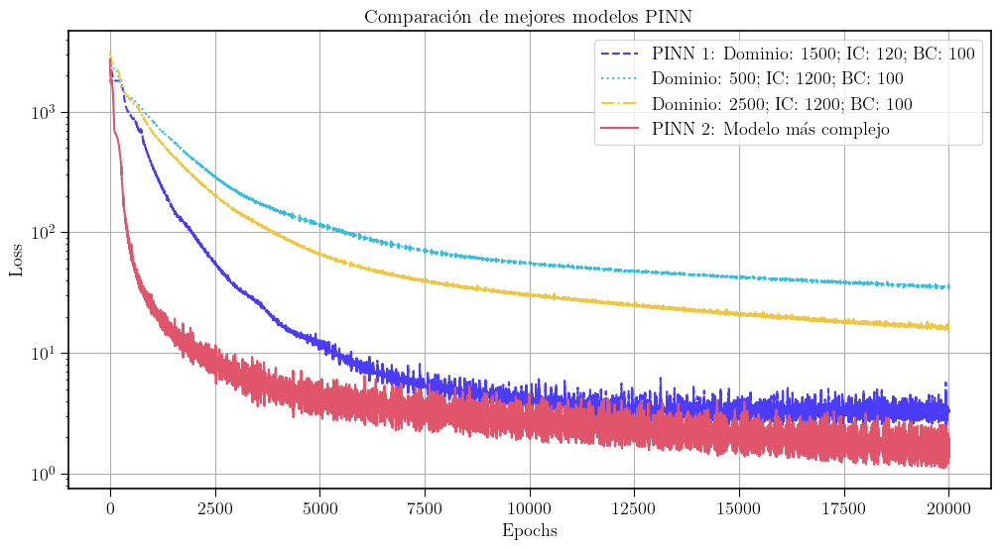

In [19]:
testmetric234 = np.array(losshistory234.metrics_test)*F**2

colors = [
    "#4B3CFA", 
    "#33BFE3",  
    "#28A87D", 
    "#F0C640",  
    "#E1556A", 
]

plt.figure(figsize=(12, 6))
plt.plot(testmetric134[:, 0], label="PINN 1: Dominio: 1500; IC: 120; BC: 100", linestyle='--', color=colors[0])
plt.plot(testmetric12[:, 0], label="Dominio: 500; IC: 1200; BC: 100", linestyle=':', color = colors[1])
plt.plot(testmetric13[:, 0], label="Dominio: 2500; IC: 1200; BC: 100", linestyle='-.', color = colors[3])
plt.plot(testmetric234[:, 0], label="PINN 2: Modelo más complejo", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Comparación de mejores modelos PINN")
plt.legend()
plt.grid(True)
plt.show()

Se añade un modelo con la misma arquitectura que la curva azul oscuro anterior pero reescalando la entrada u.

In [20]:
F = 1 # Reescalado.

In [21]:
# Se reescala la geometría del espacio.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [22]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    EDPreescaladox,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution= u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[1, 1, 1, 1])
# Entrenar el modelo.
losshistory79, train_state = model.train(iterations=20000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.017604 s

'compile' took 0.159936 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [7.49e-02, 7.49e-02, 6.37e-02, 7.13e+03]    [6.38e-02, 7.49e-02, 6.37e-02, 7.13e+03]    [2.77e+03]    
1         [3.66e-02, 1.39e-01, 3.01e-01, 7.11e+03]    [3.18e-02, 1.39e-01, 3.01e-01, 7.11e+03]    [2.75e+03]    
2         [8.02e-02, 2.21e-01, 7.14e-01, 7.10e+03]    [8.35e-02, 2.21e-01, 7.14e-01, 7.10e+03]    [2.73e+03]    
3         [2.13e-01, 3.29e-01, 1.31e+00, 7.09e+03]    [2.26e-01, 3.29e-01, 1.31e+00, 7.09e+03]    [2.72e+03]    
4         [4.42e-01, 4.75e-01, 2.10e+00, 7.07e+03]    [4.65e-01, 4.75e-01, 2.10e+00, 7.07e+03]    [2.70e+03]    
5         [7.76e-01, 6.70e-01, 3.11e+00, 7.06e+03]    [8.10e-01, 6.70e-01, 3.11e+00, 7.06e+03]    [2.68e+03]    
6         [1.23e+00, 9.22e-01, 4.34e+00, 7.04e+03]    [1.28e+00, 9.22e-01, 4.34

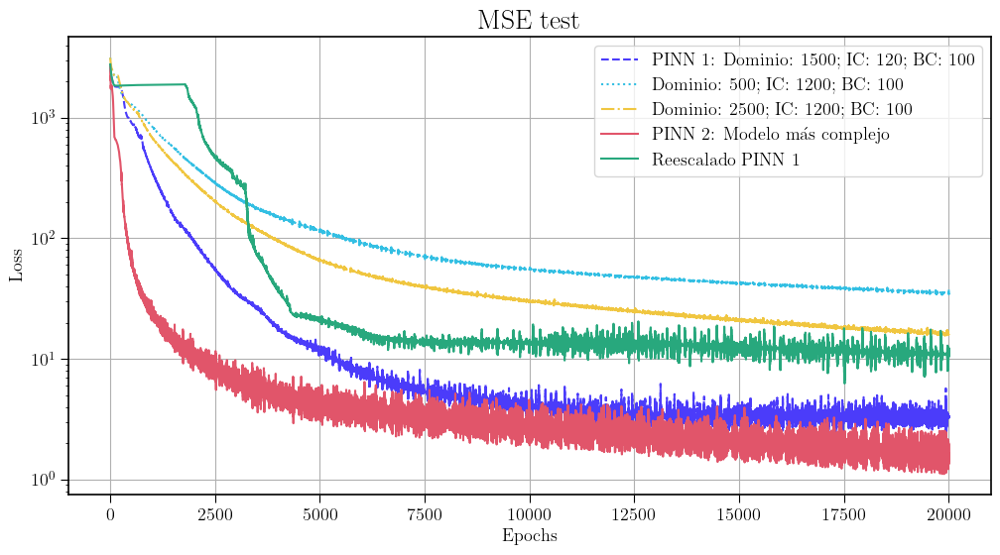

In [23]:
testmetric79 = np.array(losshistory79.metrics_test)*F**2

colors = [
    "#4B3CFA", 
    "#33BFE3",  
    "#28A87D", 
    "#F0C640", 
    "#E1556A", 
]

plt.figure(figsize=(12, 6))
plt.plot(testmetric134[:, 0], label="PINN 1: Dominio: 1500; IC: 120; BC: 100", linestyle='--', color=colors[0])
plt.plot(testmetric12[:, 0], label="Dominio: 500; IC: 1200; BC: 100", linestyle=':', color = colors[1])
plt.plot(testmetric13[:, 0], label="Dominio: 2500; IC: 1200; BC: 100", linestyle='-.', color = colors[3])
plt.plot(testmetric234[:, 0], label="PINN 2: Modelo más complejo", linestyle='-', color = colors[4])
plt.plot(testmetric79[:, 0], label="Reescalado PINN 1", linestyle='-', color = colors[2])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("MSE test", fontsize=20)
plt.legend()
plt.grid(True)
plt.show()

### vanilla-PINN 2 (Reescalado de la función, 1/100)
Optimizador: Adam

Función de activación: tanh

Collocation points: 1500

Boundary points: 100

Initial points: 120

Nº de capas profundas: 2

Nº de neuronas: 16

lr = 0.01

Peso de la función error, todos 1.

In [24]:
F = 100 # Reescalado.

In [25]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [26]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[1, 1, 1, 1])
# Entrenar el modelo.
losshistory1, train_state = model.train(iterations=10000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.015758 s

'compile' took 0.167076 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.06e-01, 6.41e-02, 3.38e-02, 7.11e-01]    [9.24e-02, 6.41e-02, 3.38e-02, 7.11e-01]    [1.82e-01]    
1         [4.18e-02, 1.08e-01, 1.16e-01, 5.43e-01]    [3.88e-02, 1.08e-01, 1.16e-01, 5.43e-01]    [6.64e-02]    
2         [3.87e-02, 5.34e-02, 1.00e-01, 5.42e-01]    [3.92e-02, 5.34e-02, 1.00e-01, 5.42e-01]    [6.13e-02]    
3         [1.73e-02, 1.02e-02, 1.81e-02, 5.45e-01]    [1.78e-02, 1.02e-02, 1.81e-02, 5.45e-01]    [8.31e-02]    
4         [5.62e-03, 6.58e-04, 3.38e-03, 5.83e-01]    [5.59e-03, 6.58e-04, 3.38e-03, 5.83e-01]    [1.65e-01]    
5         [5.04e-03, 1.13e-02, 2.26e-02, 6.09e-01]    [4.55e-03, 1.13e-02, 2.26e-02, 6.09e-01]    [2.32e-01]    
6         [9.68e-03, 1.95e-02, 1.68e-02, 5.88e-01]    [8.62e-03, 1.95e-02, 1.68

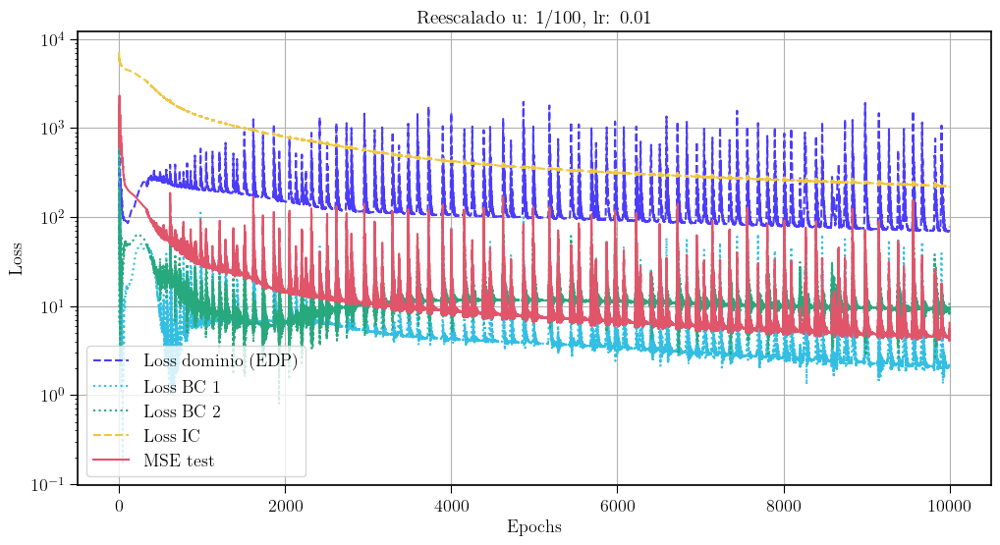

In [27]:
loss_train = np.array(losshistory1.loss_train)*F**2
testmetric2 = np.array(losshistory1.metrics_test)*F**2

colors = [
    "#4B3CFA", 
    "#33BFE3", 
    "#28A87D", 
    "#F0C640",  
    "#E1556A", 
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric2[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Reescalado u: 1/100, lr: 0.01")
plt.legend()
plt.grid(True)
plt.show()

### vanilla-PINN 3 (Reescalado de la función, 1/1000)
Optimizador: Adam

Función de activación: tanh

Collocation points: 1500

Boundary points: 100

Initial points: 120

Nº de capas profundas: 2

Nº de neuronas: 16

lr = 0.01

Peso de la función error, todos 1.

In [28]:
F = 1000 # Reescalado.

In [29]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [30]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[1, 1, 1, 1])
# Entrenar el modelo.
losshistory1, train_state = model.train(iterations=10000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.017896 s

'compile' took 0.194655 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.06e-01, 6.59e-02, 3.48e-02, 2.14e-02]    [9.24e-02, 6.59e-02, 3.48e-02, 2.14e-02]    [2.72e-02]    
1         [3.74e-02, 7.98e-02, 9.08e-02, 9.00e-02]    [3.46e-02, 7.98e-02, 9.08e-02, 9.00e-02]    [1.63e-01]    
2         [1.68e-02, 1.98e-02, 1.45e-02, 3.02e-02]    [1.51e-02, 1.98e-02, 1.45e-02, 3.02e-02]    [4.92e-02]    
3         [1.28e-02, 1.62e-03, 1.64e-02, 6.66e-03]    [1.13e-02, 1.62e-03, 1.64e-02, 6.66e-03]    [2.51e-03]    
4         [1.56e-02, 1.49e-02, 6.01e-02, 1.98e-02]    [1.47e-02, 1.49e-02, 6.01e-02, 1.98e-02]    [2.05e-02]    
5         [6.90e-03, 2.60e-02, 4.46e-02, 1.27e-02]    [6.35e-03, 2.60e-02, 4.46e-02, 1.27e-02]    [1.83e-02]    
6         [2.86e-03, 2.61e-02, 9.10e-03, 5.56e-03]    [2.44e-03, 2.61e-02, 9.10

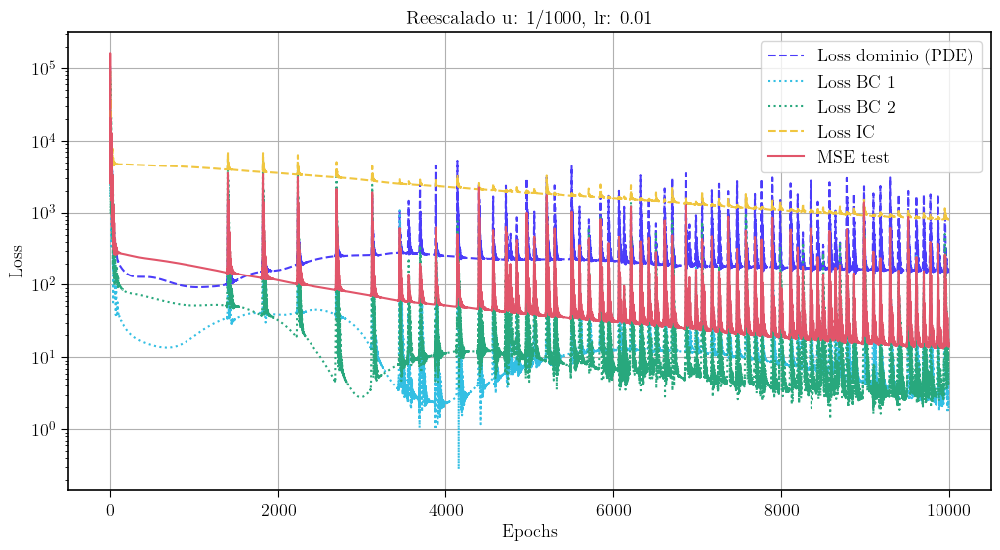

In [31]:
loss_train = np.array(losshistory1.loss_train)*F**2
testmetric3 = np.array(losshistory1.metrics_test)*F**2

colors = [
    "#4B3CFA",  
    "#33BFE3",  
    "#28A87D",  
    "#F0C640",  
    "#E1556A",  
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (PDE)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric3[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Reescalado u: 1/1000, lr: 0.01")
plt.legend()
plt.grid(True)
plt.show()

### vanilla-PINN 4 (Reescalado de la función, 1/100)(Reescalado de la entrada x, 1/L)
Optimizador: Adam

Función de activación: tanh

Collocation points: 1500

Boundary points: 100

Initial points: 120

Nº de capas profundas: 2

Nº de neuronas: 16

lr = 0.01

Peso de la función error, todos 1.

In [32]:
F = 1000 # Reescalado.

In [33]:
# Se reescala la geometría del espacio.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [34]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    EDPreescaladox,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution= u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[1, 1, 1, 1])
# Entrenar el modelo.
losshistory1, train_state = model.train(iterations=10000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.017668 s

'compile' took 0.174105 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [7.50e-02, 6.16e-02, 7.63e-02, 6.51e-03]    [6.38e-02, 6.16e-02, 7.63e-02, 6.51e-03]    [5.63e-02]    
1         [5.25e-02, 3.76e-03, 6.26e-03, 3.26e-02]    [4.95e-02, 3.76e-03, 6.26e-03, 3.26e-02]    [9.43e-03]    
2         [3.89e-03, 5.53e-03, 1.01e-02, 1.79e-02]    [4.14e-03, 5.53e-03, 1.01e-02, 1.79e-02]    [1.73e-02]    
3         [1.44e-02, 8.29e-03, 3.47e-03, 6.55e-03]    [1.27e-02, 8.29e-03, 3.47e-03, 6.55e-03]    [1.39e-02]    
4         [4.96e-02, 7.37e-03, 4.15e-03, 1.20e-02]    [4.54e-02, 7.37e-03, 4.15e-03, 1.20e-02]    [9.58e-03]    
5         [5.97e-02, 5.86e-03, 6.24e-03, 1.60e-02]    [5.52e-02, 5.86e-03, 6.24e-03, 1.60e-02]    [8.14e-03]    
6         [4.25e-02, 4.27e-03, 3.65e-03, 1.17e-02]    [3.92e-02, 4.27e-03, 3.65

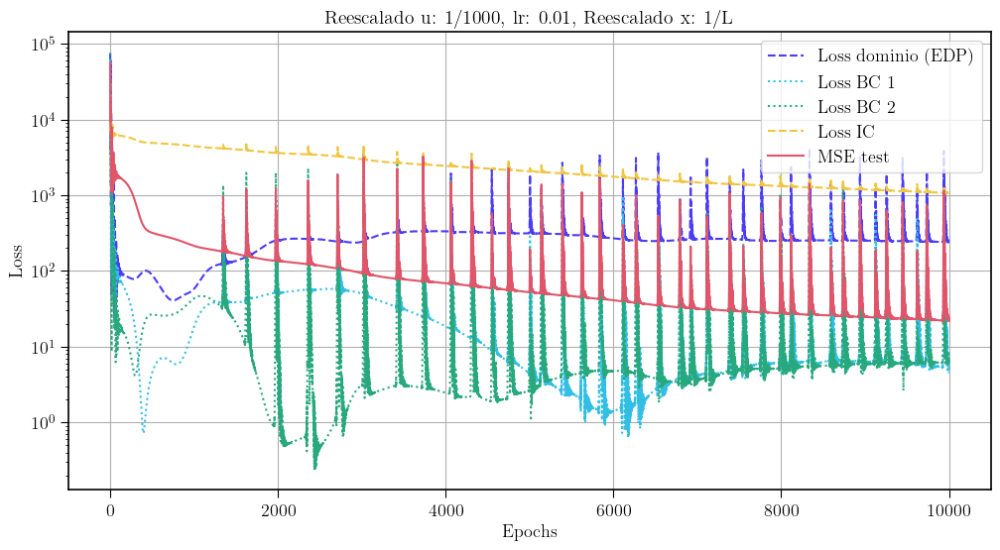

In [35]:
loss_train = np.array(losshistory1.loss_train)*F**2
testmetric4 = np.array(losshistory1.metrics_test)*F**2

colors = [
    "#4B3CFA",  
    "#33BFE3", 
    "#28A87D", 
    "#F0C640", 
    "#E1556A", 
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric4[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Reescalado u: 1/1000, lr: 0.01, Reescalado x: 1/L")
plt.legend()
plt.grid(True)
plt.show()

### vanilla-PINN 5 (Reescalado de la función, 1/50)(Reescalado de la entrada x, 1/L)
Optimizador: Adam

Función de activación: tanh

Collocation points: 1500

Boundary points: 100

Initial points: 120

Nº de capas profundas: 2

Nº de neuronas: 16

lr = 0.01

Peso de la función error, todos 1.

In [36]:
F = 50 # Reescalado.

In [37]:
# Se reescala la geometría del espacio.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [38]:
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    EDPreescaladox,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution= u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[1, 1, 1, 1])
# Entrenar el modelo.
losshistory1, train_state = model.train(iterations=10000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.015992 s

'compile' took 0.175181 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [7.50e-02, 6.96e-02, 6.85e-02, 2.81e+00]    [6.38e-02, 6.96e-02, 6.85e-02, 2.81e+00]    [7.52e-01]    
1         [7.60e-03, 3.88e-02, 7.86e-02, 2.66e+00]    [7.84e-03, 3.88e-02, 7.86e-02, 2.66e+00]    [7.62e-01]    
2         [5.55e-02, 1.65e-02, 4.17e-02, 2.61e+00]    [5.46e-02, 1.65e-02, 4.17e-02, 2.61e+00]    [8.65e-01]    
3         [1.25e-01, 9.97e-03, 1.22e-02, 2.60e+00]    [1.17e-01, 9.97e-03, 1.22e-02, 2.60e+00]    [1.02e+00]    
4         [1.69e-01, 1.31e-02, 9.81e-03, 2.60e+00]    [1.55e-01, 1.31e-02, 9.81e-03, 2.60e+00]    [1.10e+00]    
5         [1.84e-01, 1.77e-02, 9.66e-03, 2.58e+00]    [1.69e-01, 1.77e-02, 9.66e-03, 2.58e+00]    [1.07e+00]    
6         [1.72e-01, 2.75e-02, 8.65e-03, 2.55e+00]    [1.60e-01, 2.75e-02, 8.65

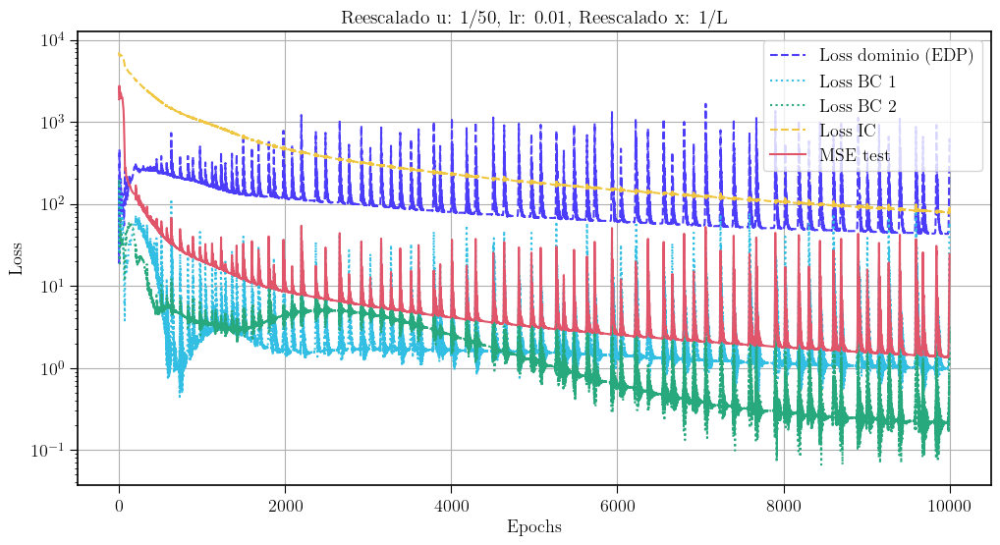

In [39]:
loss_train = np.array(losshistory1.loss_train)*F**2
testmetric5 = np.array(losshistory1.metrics_test)*F**2

colors = [
    "#4B3CFA",  
    "#33BFE3",  
    "#28A87D", 
    "#F0C640",  
    "#E1556A", 
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric5[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Reescalado u: 1/50, lr: 0.01, Reescalado x: 1/L")
plt.legend()
plt.grid(True)
plt.show()

### vanilla-PINN 6 (Reescalado de la función, 1/1000) -Se reduce learning rate-
Optimizador: Adam

Función de activación: tanh

Collocation points: 1500

Boundary points: 100

Initial points: 120

Nº de capas profundas: 2

Nº de neuronas: 16

lr = 0.001

Peso de la función error, todos 1.

In [40]:
F = 1000 # Reescalado.

In [41]:
# Se reescala la geometría del espacio.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [42]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[1, 1, 1, 1])
# Entrenar el modelo.
losshistory1, train_state = model.train(iterations=10000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.016165 s

'compile' took 0.191810 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.06e-01, 6.64e-02, 3.51e-02, 2.14e-02]    [9.24e-02, 6.64e-02, 3.51e-02, 2.14e-02]    [2.72e-02]    
1         [8.89e-02, 6.78e-02, 2.09e-02, 1.39e-02]    [7.68e-02, 6.78e-02, 2.09e-02, 1.39e-02]    [2.94e-02]    
2         [7.44e-02, 6.78e-02, 1.20e-02, 9.87e-03]    [6.35e-02, 6.78e-02, 1.20e-02, 9.87e-03]    [3.31e-02]    
3         [6.26e-02, 6.61e-02, 7.06e-03, 8.59e-03]    [5.28e-02, 6.61e-02, 7.06e-03, 8.59e-03]    [3.75e-02]    
4         [5.34e-02, 6.27e-02, 5.02e-03, 9.06e-03]    [4.47e-02, 6.27e-02, 5.02e-03, 9.06e-03]    [4.12e-02]    
5         [4.63e-02, 5.77e-02, 4.58e-03, 1.03e-02]    [3.85e-02, 5.77e-02, 4.58e-03, 1.03e-02]    [4.37e-02]    
6         [4.08e-02, 5.17e-02, 4.74e-03, 1.16e-02]    [3.39e-02, 5.17e-02, 4.74

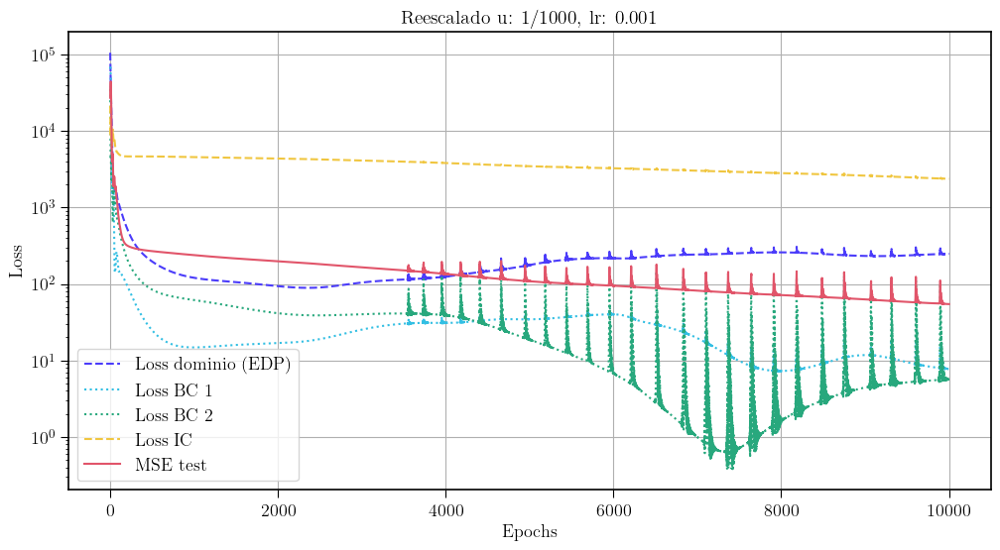

In [ ]:
loss_train = np.array(losshistory1.loss_train)* F**2
testmetric7 = np.array(losshistory1.metrics_test)* F**2

colors = [
    "#4B3CFA", 
    "#33BFE3",  
    "#28A87D",  
    "#F0C640", 
    "#E1556A",  
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric7[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Reescalado u: 1/1000, lr: 0.001")
plt.legend()
plt.grid(True)
plt.show()

### vanilla-PINN 7
Optimizador: Adam

Función de activación: tanh

Collocation points: 1500

Boundary points: 100

Initial points: 120

Nº de capas profundas: 2

Nº de neuronas: 16

lr = 0.001

Peso de la función error, todos 1.

In [44]:
F = 1 # Reescalado.

In [45]:
# Se reescala la geometría del espacio.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [46]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[1, 1, 1, 1])
# Entrenar el modelo.
losshistory1, train_state = model.train(iterations=10000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.015553 s

'compile' took 0.190883 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.06e-01, 6.34e-02, 3.33e-02, 7.13e+03]    [9.24e-02, 6.34e-02, 3.33e-02, 7.13e+03]    [2.74e+03]    
1         [8.93e-02, 6.81e-02, 1.88e-02, 7.13e+03]    [7.70e-02, 6.81e-02, 1.88e-02, 7.13e+03]    [2.74e+03]    
2         [7.54e-02, 7.31e-02, 9.59e-03, 7.12e+03]    [6.39e-02, 7.31e-02, 9.59e-03, 7.12e+03]    [2.74e+03]    
3         [6.37e-02, 7.83e-02, 5.84e-03, 7.12e+03]    [5.31e-02, 7.83e-02, 5.84e-03, 7.12e+03]    [2.73e+03]    
4         [5.43e-02, 8.38e-02, 7.48e-03, 7.12e+03]    [4.45e-02, 8.38e-02, 7.48e-03, 7.12e+03]    [2.73e+03]    
5         [4.72e-02, 8.95e-02, 1.45e-02, 7.11e+03]    [3.83e-02, 8.95e-02, 1.45e-02, 7.11e+03]    [2.72e+03]    
6         [4.23e-02, 9.54e-02, 2.69e-02, 7.11e+03]    [3.44e-02, 9.54e-02, 2.69

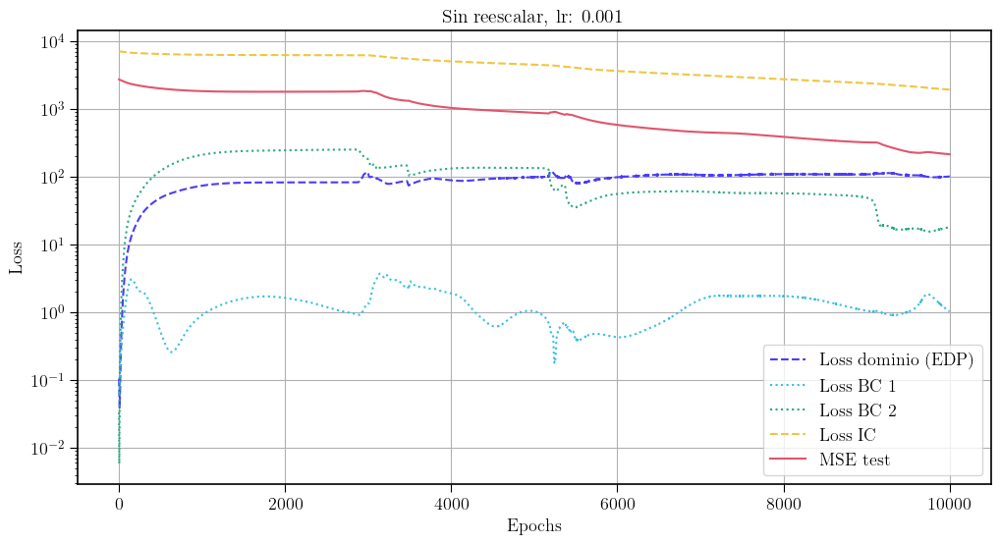

In [47]:
loss_train = np.array(losshistory1.loss_train)* F**2
testmetric8 = np.array(losshistory1.metrics_test)* F**2

colors = [
    "#4B3CFA",  
    "#33BFE3", 
    "#28A87D",  
    "#F0C640",  
    "#E1556A", 
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric8[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Sin reescalar, lr: 0.001")
plt.legend()
plt.grid(True)
plt.show()

### Comparación del error en el test de todos los modelos (Reescalados y no reescalados)

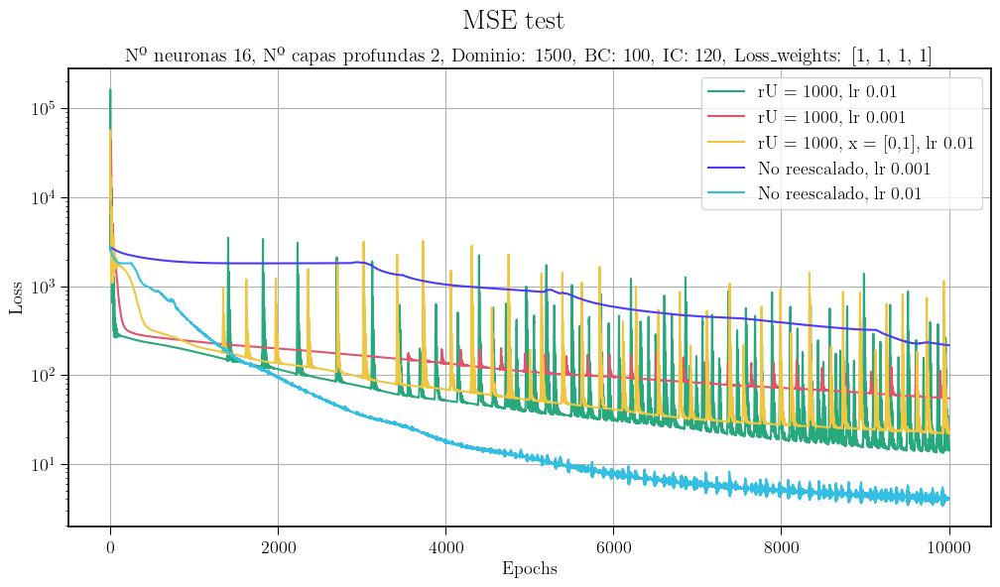

In [ ]:
colors = [
    "#4B3CFA", 
    "#33BFE3", 
    "#28A87D", 
    "#F0C640", 
    "#E1556A",
]

plt.figure(figsize=(12, 6))
plt.plot(testmetric3[:, 0], label="rU = 1000, lr 0.01", linestyle='-', color = colors[2])
plt.plot(testmetric7[:, 0], label="rU = 1000, lr 0.001", linestyle='-', color = colors[4])
plt.plot(testmetric4[:, 0], label="rU = 1000, x = [0,1], lr 0.01", linestyle='-', color = colors[3])
plt.plot(testmetric8[:, 0], label="No reescalado, lr 0.001", linestyle='-', color = colors[0])
plt.plot(testmetric1[:], label="No reescalado, lr 0.01", linestyle='-', color = colors[1])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.suptitle("MSE test", fontsize=20)
plt.title("Nº neuronas 16, Nº capas profundas 2, Dominio: 1500, BC: 100, IC: 120, Loss_weights: [1, 1, 1, 1]")
plt.legend()
plt.grid(True)
plt.show()

## Aumento del nº de collocation points y nº de initial points 

### vanilla-PINN 8
Optimizador: Adam

Función de activación: tanh

Collocation points: 2500

Boundary points: 100

Initial points: 1200

Nº de capas profundas: 2

Nº de neuronas: 16

lr = 0.001

Peso de la función error, todos 1.

In [49]:
F = 1 # Reescalado.

In [50]:
# Se reescala la geometría del espacio.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [51]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[1, 1, 1, 1])
# Entrenar el modelo.
losshistory1, train_state = model.train(iterations=10000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.018753 s

'compile' took 0.213971 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.32e-01, 5.49e-02, 2.98e-02, 7.08e+03]    [9.24e-02, 5.49e-02, 2.98e-02, 7.08e+03]    [3.14e+03]    
1         [1.14e-01, 5.91e-02, 1.62e-02, 7.08e+03]    [7.70e-02, 5.91e-02, 1.62e-02, 7.08e+03]    [3.14e+03]    
2         [9.83e-02, 6.36e-02, 7.98e-03, 7.07e+03]    [6.39e-02, 6.36e-02, 7.98e-03, 7.07e+03]    [3.14e+03]    
3         [8.45e-02, 6.83e-02, 5.12e-03, 7.07e+03]    [5.31e-02, 6.83e-02, 5.12e-03, 7.07e+03]    [3.13e+03]    
4         [7.31e-02, 7.32e-02, 7.62e-03, 7.07e+03]    [4.46e-02, 7.32e-02, 7.62e-03, 7.07e+03]    [3.13e+03]    
5         [6.39e-02, 7.84e-02, 1.55e-02, 7.06e+03]    [3.83e-02, 7.84e-02, 1.55e-02, 7.06e+03]    [3.13e+03]    
6         [5.70e-02, 8.39e-02, 2.86e-02, 7.06e+03]    [3.44e-02, 8.39e-02, 2.86

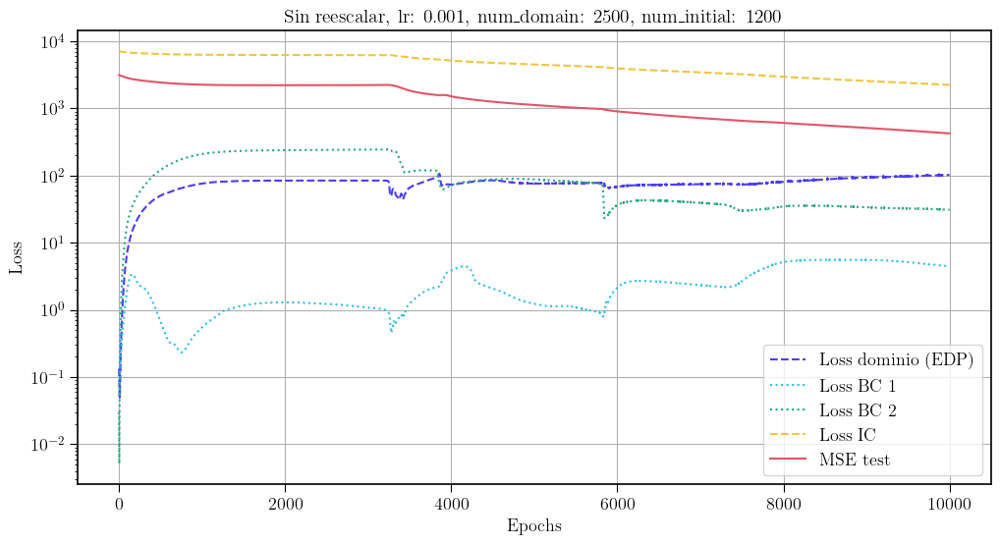

In [52]:
loss_train = np.array(losshistory1.loss_train)* F**2
testmetric9 = np.array(losshistory1.metrics_test)* F**2

colors = [
    "#4B3CFA", 
    "#33BFE3",  
    "#28A87D",  
    "#F0C640",  
    "#E1556A",  
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric9[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Sin reescalar, lr: 0.001, num_domain: 2500, num_initial: 1200")
plt.legend()
plt.grid(True)
plt.show()

### vanilla-PINN 9 -Cambio del peso de la función de pérdida-
Optimizador: Adam

Función de activación: tanh

Collocation points: 2500

Boundary points: 100

Initial points: 1200

Nº de capas profundas: 2

Nº de neuronas: 16

lr = 0.001

Peso función de pérdida inicial 4.

In [53]:
F = 1 # Reescalado.

In [54]:
# Se reescala la geometría del espacio.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [55]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[1, 1, 1, 4])
# Entrenar el modelo.
losshistory1, train_state = model.train(iterations=10000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.016938 s

'compile' took 0.214699 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.32e-01, 6.65e-02, 3.52e-02, 2.83e+04]    [9.24e-02, 6.65e-02, 3.52e-02, 2.83e+04]    [3.14e+03]    
1         [1.14e-01, 7.13e-02, 2.00e-02, 2.83e+04]    [7.70e-02, 7.13e-02, 2.00e-02, 2.83e+04]    [3.14e+03]    
2         [9.82e-02, 7.65e-02, 1.03e-02, 2.83e+04]    [6.39e-02, 7.65e-02, 1.03e-02, 2.83e+04]    [3.14e+03]    
3         [8.45e-02, 8.18e-02, 6.00e-03, 2.83e+04]    [5.31e-02, 8.18e-02, 6.00e-03, 2.83e+04]    [3.13e+03]    
4         [7.31e-02, 8.74e-02, 7.12e-03, 2.83e+04]    [4.45e-02, 8.74e-02, 7.12e-03, 2.83e+04]    [3.13e+03]    
5         [6.39e-02, 9.33e-02, 1.36e-02, 2.83e+04]    [3.83e-02, 9.33e-02, 1.36e-02, 2.83e+04]    [3.13e+03]    
6         [5.70e-02, 9.94e-02, 2.55e-02, 2.82e+04]    [3.44e-02, 9.94e-02, 2.55

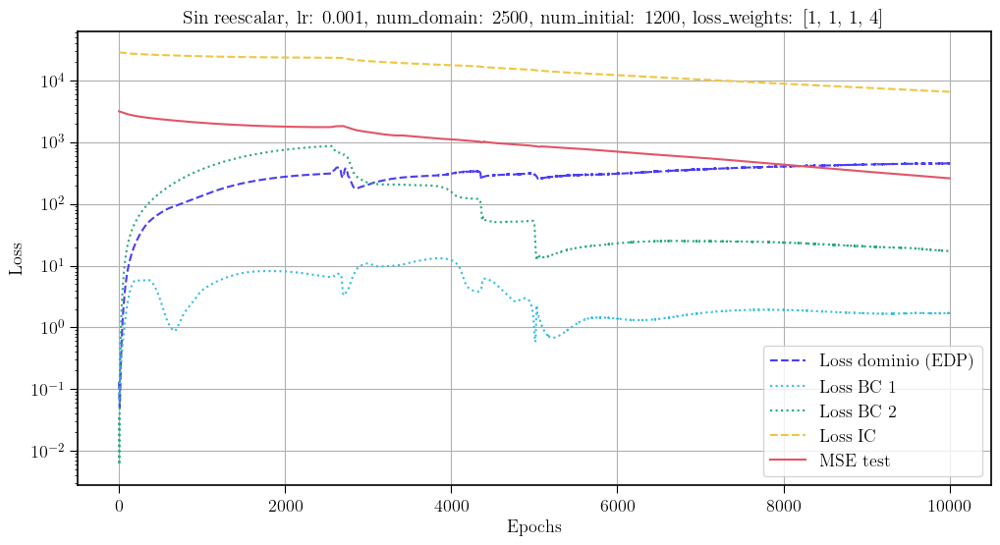

In [56]:
loss_train = np.array(losshistory1.loss_train)* F**2
testmetric10 = np.array(losshistory1.metrics_test)* F**2

colors = [
    "#4B3CFA", 
    "#33BFE3", 
    "#28A87D",  
    "#F0C640", 
    "#E1556A",  
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric10[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Sin reescalar, lr: 0.001, num_domain: 2500, num_initial: 1200, loss_weights: [1, 1, 1, 4]")
plt.legend()
plt.grid(True)
plt.show()

### vanilla-PINN 10 -Aumento de nº de neuronas y nº de capas-
Optimizador: Adam

Función de activación: tanh

Collocation points: 2500

Boundary points: 100

Initial points: 1200

Nº de capas profundas: 4

Nº de neuronas: 32

lr = 0.001

Peso función de pérdida inicial 4.

In [57]:
F = 1 # Reescalado.

In [58]:
# Se reescala la geometría del espacio.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [59]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[1, 1, 1, 4])
# Entrenar el modelo.
losshistory1, train_state = model.train(iterations=10000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.026611 s

'compile' took 0.272244 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.15e-02, 9.84e-04, 1.28e-02, 2.83e+04]    [1.04e-02, 9.84e-04, 1.28e-02, 2.83e+04]    [3.15e+03]    
1         [1.73e-02, 4.63e-03, 4.12e-02, 2.82e+04]    [1.71e-02, 4.63e-03, 4.12e-02, 2.82e+04]    [3.13e+03]    
2         [9.32e-02, 1.11e-02, 2.67e-01, 2.82e+04]    [9.80e-02, 1.11e-02, 2.67e-01, 2.82e+04]    [3.11e+03]    
3         [2.40e-01, 2.09e-02, 6.86e-01, 2.81e+04]    [2.54e-01, 2.09e-02, 6.86e-01, 2.81e+04]    [3.09e+03]    
4         [4.58e-01, 3.41e-02, 1.29e+00, 2.80e+04]    [4.83e-01, 3.41e-02, 1.29e+00, 2.80e+04]    [3.07e+03]    
5         [7.43e-01, 5.08e-02, 2.07e+00, 2.80e+04]    [7.81e-01, 5.08e-02, 2.07e+00, 2.80e+04]    [3.05e+03]    
6         [1.09e+00, 7.10e-02, 3.00e+00, 2.79e+04]    [1.14e+00, 7.10e-02, 3.00

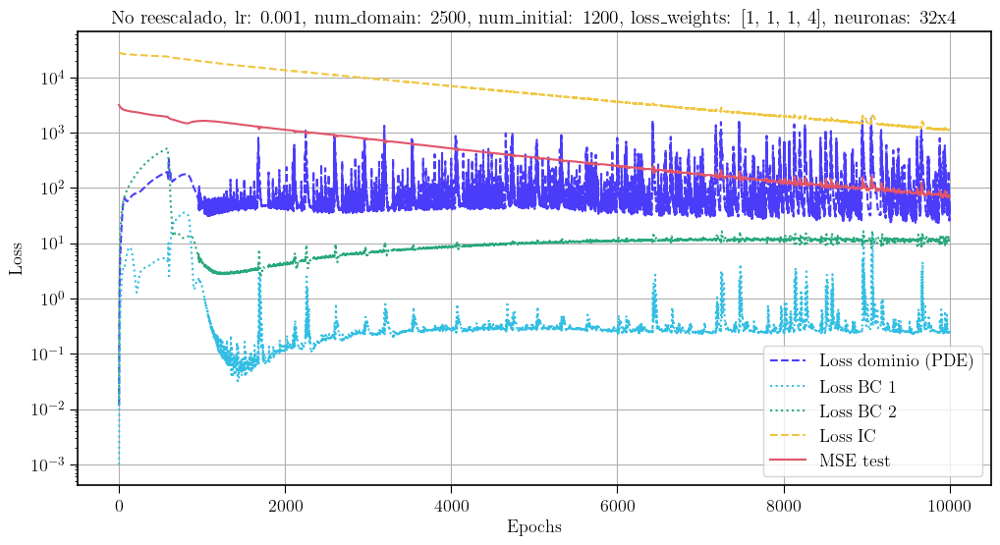

In [60]:
loss_train = np.array(losshistory1.loss_train)* F**2
testmetric11 = np.array(losshistory1.metrics_test)* F**2

colors = [
    "#4B3CFA",  
    "#33BFE3",  
    "#28A87D", 
    "#F0C640",  
    "#E1556A",  
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (PDE)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric11[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("No reescalado, lr: 0.001, num_domain: 2500, num_initial: 1200, loss_weights: [1, 1, 1, 4], neuronas: 32x4")
plt.legend()
plt.grid(True)
plt.show()

#### Volvemos a probar los reescalados pero ahora con la arquitectura de red anterior.

### vanilla-PINN 11 (Reescalado de la función, 1/1000)
Optimizador: Adam

Función de activación: tanh

Collocation points: 2500

Boundary points: 100

Initial points: 1200

Nº de capas profundas: 4

Nº de neuronas: 32

lr = 0.01

Peso en el error IC de 4

In [61]:
F = 1000 # Reescalado.

In [62]:
# Se reescala la geometría del espacio.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [63]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[1, 1, 1, 4])
# Entrenar el modelo.
losshistory1, train_state = model.train(iterations=10000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.026898 s

'compile' took 0.283341 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.15e-02, 7.95e-04, 1.15e-02, 4.10e-02]    [1.04e-02, 7.95e-04, 1.15e-02, 4.10e-02]    [5.01e-03]    
1         [2.87e+00, 8.82e-02, 6.74e+00, 2.05e+01]    [2.93e+00, 8.82e-02, 6.74e+00, 2.05e+01]    [4.56e+00]    
2         [3.70e-01, 9.91e-03, 6.15e-01, 2.01e+00]    [3.51e-01, 9.91e-03, 6.15e-01, 2.01e+00]    [3.74e-01]    
3         [2.74e-01, 9.39e-02, 9.62e-01, 2.81e+00]    [3.00e-01, 9.39e-02, 9.62e-01, 2.81e+00]    [7.77e-01]    
4         [5.75e-01, 8.02e-02, 1.50e+00, 5.05e+00]    [6.01e-01, 8.02e-02, 1.50e+00, 5.05e+00]    [1.24e+00]    
5         [3.01e-01, 2.02e-02, 5.01e-01, 2.28e+00]    [2.97e-01, 2.02e-02, 5.01e-01, 2.28e+00]    [4.90e-01]    
6         [3.94e-02, 5.88e-03, 2.79e-03, 1.34e-01]    [2.77e-02, 5.88e-03, 2.79

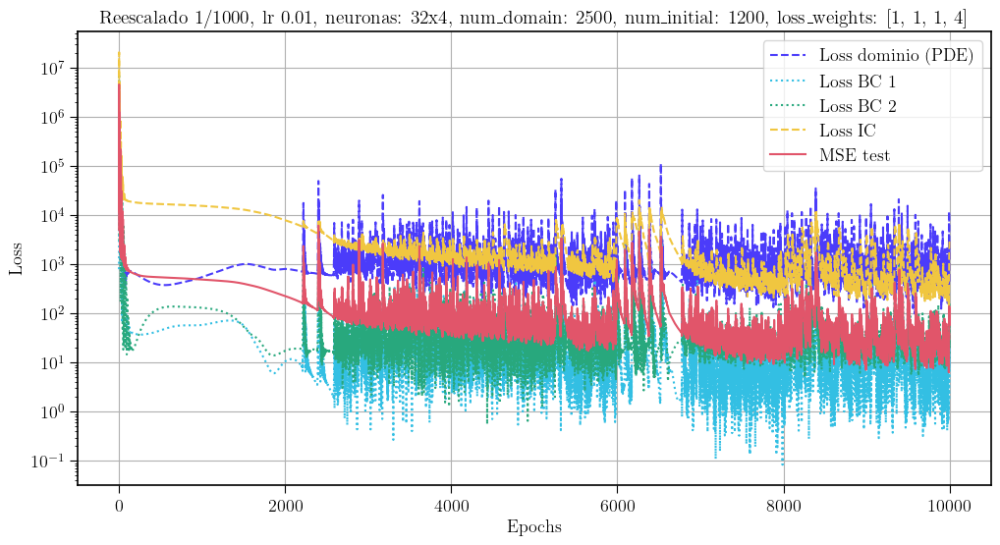

In [64]:
loss_train = np.array(losshistory1.loss_train)*F**2
testmetric3 = np.array(losshistory1.metrics_test)*F**2

colors = [
    "#4B3CFA",  
    "#33BFE3", 
    "#28A87D",  
    "#F0C640",  
    "#E1556A",  
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (PDE)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric3[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Reescalado 1/1000, lr 0.01, neuronas: 32x4, num_domain: 2500, num_initial: 1200, loss_weights: [1, 1, 1, 4]")
plt.legend()
plt.grid(True)
plt.show()

### vanilla-PINN 12 (Reescalado de la función, 1/1000)(Reescalado de la entrada x, 1/L)
Optimizador: Adam

Función de activación: tanh

Collocation points: 2500

Boundary points: 100

Initial points: 1200

Nº de capas profundas: 4

Nº de neuronas: 32

lr = 0.01

Peso en el error IC de 4

In [65]:
# Se reescala la geometría del espacio.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [66]:
F = 1000 # Reescalado.

In [67]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    EDPreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution= u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[1, 1, 1, 4])
# Entrenar el modelo.
losshistory1, train_state = model.train(iterations=10000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.025907 s

'compile' took 0.291548 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.33e-03, 9.83e-04, 7.81e-03, 2.61e-02]    [9.87e-04, 9.83e-04, 7.81e-03, 2.61e-02]    [2.57e-03]    
1         [3.65e-01, 9.76e-01, 3.30e+00, 4.46e+00]    [4.04e-01, 9.76e-01, 3.30e+00, 4.46e+00]    [2.14e+00]    
2         [4.89e-02, 1.11e-01, 3.15e-01, 3.74e-01]    [3.44e-02, 1.11e-01, 3.15e-01, 3.74e-01]    [2.35e-01]    
3         [4.07e-02, 4.44e-02, 2.71e-01, 3.90e-01]    [5.49e-02, 4.44e-02, 2.71e-01, 3.90e-01]    [1.22e-01]    
4         [8.84e-02, 2.46e-01, 7.31e-01, 7.73e-01]    [8.41e-02, 2.46e-01, 7.31e-01, 7.73e-01]    [4.20e-01]    
5         [1.46e-01, 2.80e-01, 4.61e-01, 3.09e-01]    [8.16e-02, 2.80e-01, 4.61e-01, 3.09e-01]    [3.16e-01]    
6         [1.98e-01, 1.67e-01, 8.40e-02, 2.37e-02]    [1.16e-01, 1.67e-01, 8.40

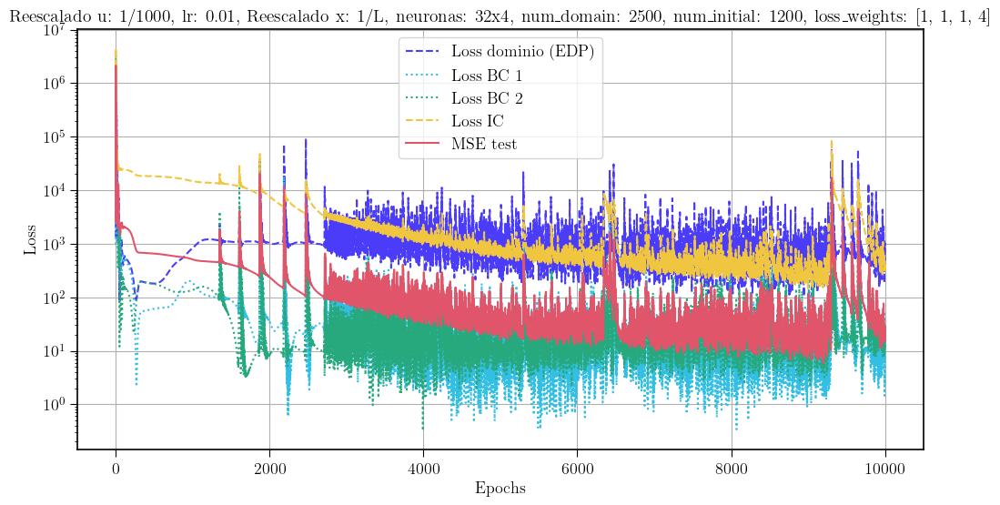

In [68]:
loss_train = np.array(losshistory1.loss_train)*F**2
testmetric4 = np.array(losshistory1.metrics_test)*F**2

colors = [
    "#4B3CFA", 
    "#33BFE3",  
    "#28A87D", 
    "#F0C640",  
    "#E1556A", 
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric4[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Reescalado u: 1/1000, lr: 0.01, Reescalado x: 1/L, neuronas: 32x4, num_domain: 2500, num_initial: 1200, loss_weights: [1, 1, 1, 4]")
plt.legend()
plt.grid(True)
plt.show()

### vanilla-PINN 13 (Reescalado de la función, 1/1000)
Optimizador: Adam

Función de activación: tanh

Collocation points: 2500

Boundary points: 100

Initial points: 1200

Nº de capas profundas: 4

Nº de neuronas: 32

lr = 0.001

Peso en el error IC de 4

In [69]:
# Se reescala la geometría del espacio.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [70]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[1, 1, 1, 4])
# Entrenar el modelo.
losshistory1, train_state = model.train(iterations=10000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.028319 s

'compile' took 0.304679 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.15e-02, 9.21e-04, 1.24e-02, 4.10e-02]    [1.04e-02, 9.21e-04, 1.24e-02, 4.10e-02]    [5.02e-03]    
1         [1.77e-02, 2.60e-03, 3.91e-02, 1.72e-01]    [1.76e-02, 2.60e-03, 3.91e-02, 1.72e-01]    [4.06e-02]    
2         [4.86e-03, 1.46e-04, 3.43e-03, 4.69e-02]    [4.32e-03, 1.46e-04, 3.43e-03, 4.69e-02]    [7.19e-03]    
3         [3.44e-03, 1.15e-03, 1.19e-02, 3.50e-02]    [3.81e-03, 1.15e-03, 1.19e-02, 3.50e-02]    [5.42e-03]    
4         [7.63e-03, 3.35e-03, 3.33e-02, 7.90e-02]    [8.92e-03, 3.35e-03, 3.33e-02, 7.90e-02]    [1.81e-02]    
5         [4.92e-03, 3.91e-03, 2.28e-02, 5.74e-02]    [5.84e-03, 3.91e-03, 2.28e-02, 5.74e-02]    [1.29e-02]    
6         [1.56e-03, 3.13e-03, 4.29e-03, 2.26e-02]    [1.58e-03, 3.13e-03, 4.29

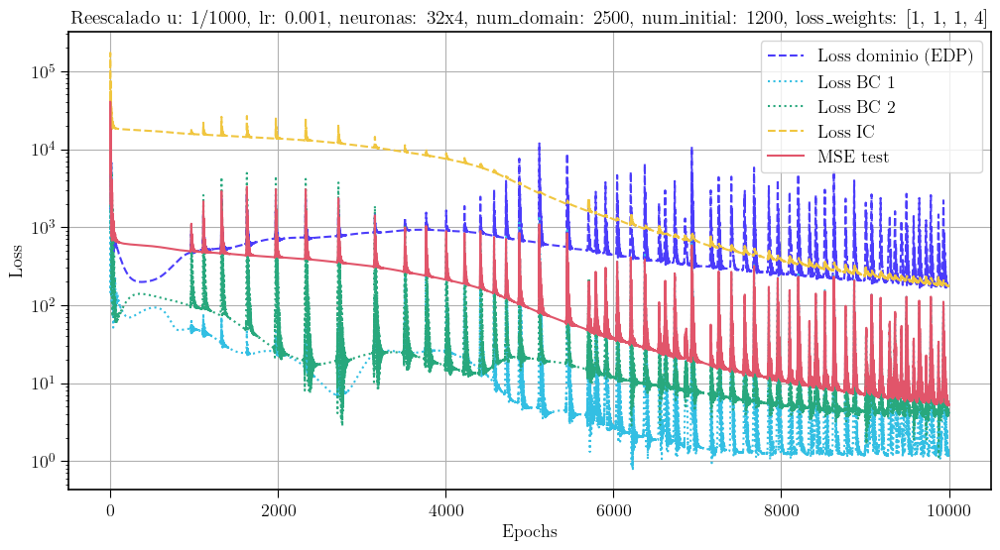

In [71]:
loss_train = np.array(losshistory1.loss_train)* F**2
testmetric8 = np.array(losshistory1.metrics_test)* F**2

colors = [
    "#4B3CFA",  
    "#33BFE3",  
    "#28A87D",  
    "#F0C640",  
    "#E1556A", 
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric8[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Reescalado u: 1/1000, lr: 0.001, neuronas: 32x4, num_domain: 2500, num_initial: 1200, loss_weights: [1, 1, 1, 4]")
plt.legend()
plt.grid(True)
plt.show()

### vanilla-PINN 14
Optimizador: Adam

Función de activación: tanh

Collocation points: 2500

Boundary points: 100

Initial points: 1200

Nº de capas profundas: 4

Nº de neuronas: 32

lr = 0.01

Peso función de pérdida inicial 4.

In [72]:
F = 1  # Reescalado.

In [73]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [74]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[1, 1, 1, 4])
# Entrenar el modelo.
losshistory1, train_state = model.train(iterations=10000,display_every=1)

Compiling model...
Building feed-forward neural network...
'build' took 0.028044 s

'compile' took 0.316437 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.15e-02, 8.88e-04, 1.22e-02, 2.83e+04]    [1.04e-02, 8.88e-04, 1.22e-02, 2.83e+04]    [3.15e+03]    
1         [2.57e+00, 1.65e-01, 6.84e+00, 2.77e+04]    [2.67e+00, 1.65e-01, 6.84e+00, 2.77e+04]    [2.98e+03]    
2         [7.55e+00, 6.83e-01, 1.74e+01, 2.73e+04]    [7.55e+00, 6.83e-01, 1.74e+01, 2.73e+04]    [2.86e+03]    
3         [1.56e+01, 1.81e+00, 2.59e+01, 2.71e+04]    [1.47e+01, 1.81e+00, 2.59e+01, 2.71e+04]    [2.78e+03]    
4         [3.26e+01, 3.85e+00, 3.46e+01, 2.69e+04]    [2.90e+01, 3.85e+00, 3.46e+01, 2.69e+04]    [2.72e+03]    
5         [6.52e+01, 6.87e+00, 4.36e+01, 2.67e+04]    [5.45e+01, 6.87e+00, 4.36e+01, 2.67e+04]    [2.66e+03]    
6         [1.12e+02, 1.07e+01, 5.23e+01, 2.66e+04]    [8.99e+01, 1.07e+01, 5.23

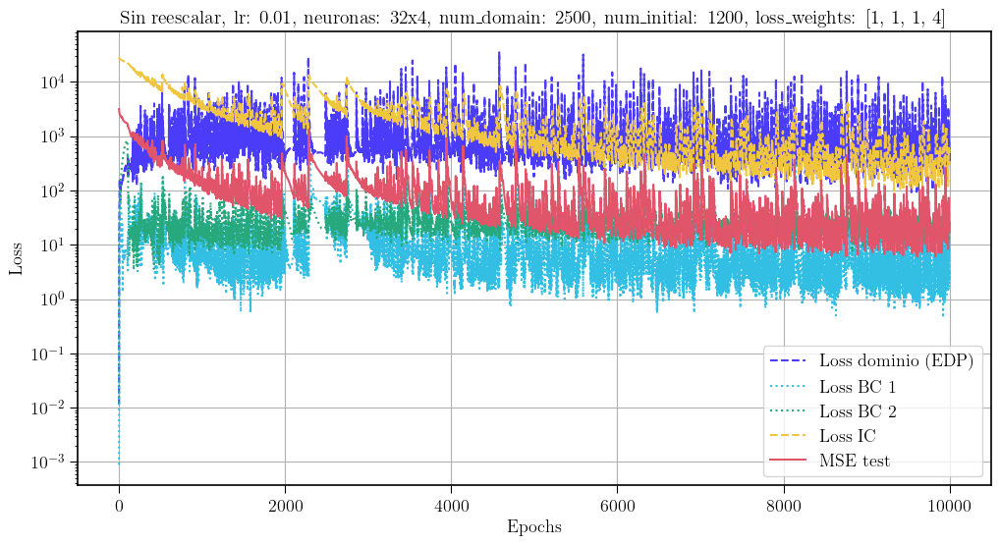

In [75]:
loss_train = np.array(losshistory1.loss_train)* F**2
testmetric1 = np.array(losshistory1.metrics_test)* F**2

colors = [
    "#4B3CFA", 
    "#33BFE3",
    "#28A87D",  
    "#F0C640",  
    "#E1556A",  
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric1[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Sin reescalar, lr: 0.01, neuronas: 32x4, num_domain: 2500, num_initial: 1200, loss_weights: [1, 1, 1, 4]")
plt.legend()
plt.grid(True)
plt.show()

### Comparación del error en el test de todos los modelos (Reescalados y no reescalados).

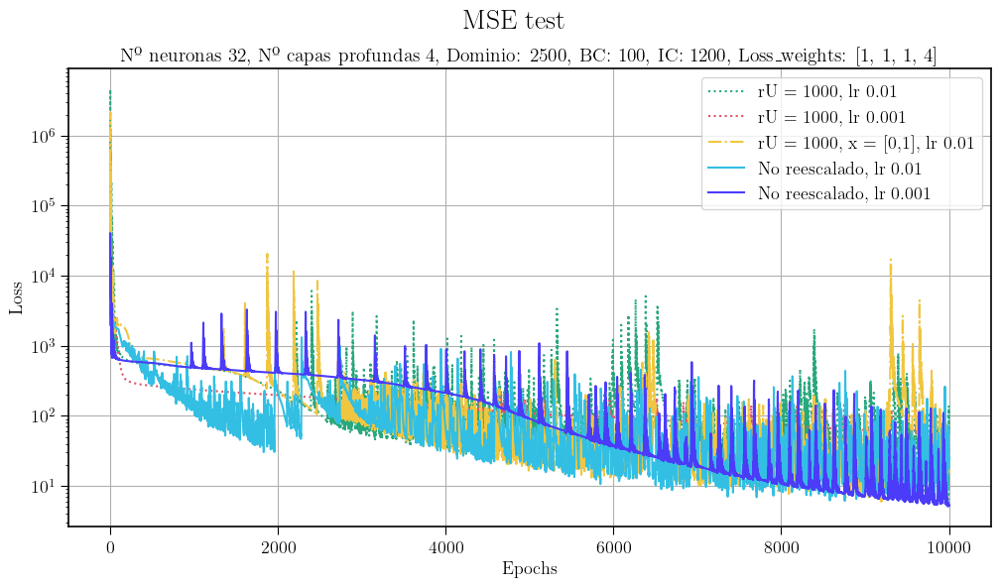

In [76]:
colors = [
    "#4B3CFA", 
    "#33BFE3",  
    "#28A87D",  
    "#F0C640", 
    "#E1556A",
]

plt.figure(figsize=(12, 6))
plt.plot(testmetric3[:, 0], label="rU = 1000, lr 0.01", linestyle=':', color = colors[2])
plt.plot(testmetric7[:, 0], label="rU = 1000, lr 0.001", linestyle=':', color = colors[4])
plt.plot(testmetric4[:, 0], label="rU = 1000, x = [0,1], lr 0.01", linestyle='-.', color = colors[3])
plt.plot(testmetric1[:, 0], label="No reescalado, lr 0.01", linestyle='-', color = colors[1])
plt.plot(testmetric8[:, 0], label="No reescalado, lr 0.001", linestyle='-', color = colors[0])


plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.suptitle("MSE test", fontsize=20)
plt.title("Nº neuronas 32, Nº capas profundas 4, Dominio: 2500, BC: 100, IC: 1200, Loss_weights: [1, 1, 1, 4]")
plt.legend()
plt.grid(True)
plt.show()

Y si el reescalado de la x es mucho más grande? x = x/2L

In [ ]:
# Funciones a llamar durante el entrenameinto de la PINN.

def ICreescaladox2(x):
    y = x[:, 0:1] * 2*L  # Reescalar x a la longitud de la barra.
    u = 50 * tf.exp(-10 * tf.square(y - 2)) * (5 - y) * y
    return u / F         # Pico de 300 ºC en x=2.

def EDPreescaladox2(x, u):
    du_t = dde.grad.jacobian(u, x, i=0, j=1)
    du_xx = dde.grad.hessian(u, x, i=0, j=0)
    return du_t - (D/(2*L)**2)*du_xx - K*u  # Reescalar x a la longitud de la barra.

def u_xt1reescaladox2(x):
    y = np.copy(x)      # Reescalar x a la longitud de la barra.
    y[:,0:1] = y[:,0:1]*2*L
    return u_xt(y) / F  # Escalar la solución.

In [ ]:
F = 1 # Reescalado.

In [ ]:
# Se reescala la geometría del espacio.
geom = dde.geometry.Interval(0, Lscalado/2)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox2(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado/2))

data = dde.data.TimePDE(
    geomtime,
    EDPreescaladox2,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution= u_xt1reescaladox2,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[1, 1, 1, 1])
# Entrenar el modelo.
losshistory79, train_state = model.train(iterations=10000,display_every=1)
loss_train = np.array(losshistory79.loss_train)*F**2

Compiling model...
Building feed-forward neural network...
'build' took 0.019878 s

'compile' took 0.276339 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [8.45e-02, 6.95e-02, 7.09e-02, 7.13e+03]    [7.25e-02, 6.95e-02, 7.09e-02, 7.13e+03]    [2.78e+03]    
1         [3.91e-02, 1.25e-01, 2.18e-01, 7.12e+03]    [3.23e-02, 1.25e-01, 2.18e-01, 7.12e+03]    [2.77e+03]    
2         [4.35e-02, 2.01e-01, 4.54e-01, 7.11e+03]    [4.31e-02, 2.01e-01, 4.54e-01, 7.11e+03]    [2.76e+03]    
3         [1.03e-01, 3.10e-01, 7.96e-01, 7.10e+03]    [1.10e-01, 3.10e-01, 7.96e-01, 7.10e+03]    [2.74e+03]    
4         [2.24e-01, 4.63e-01, 1.26e+00, 7.08e+03]    [2.40e-01, 4.63e-01, 1.26e+00, 7.08e+03]    [2.73e+03]    
5         [4.27e-01, 6.66e-01, 1.87e+00, 7.07e+03]    [4.52e-01, 6.66e-01, 1.87e+00, 7.07e+03]    [2.71e+03]    
6         [7.40e-01, 9.26e-01, 2.63e+00, 7.06e+03]    [7.77e-01, 9.26e-01, 2.63

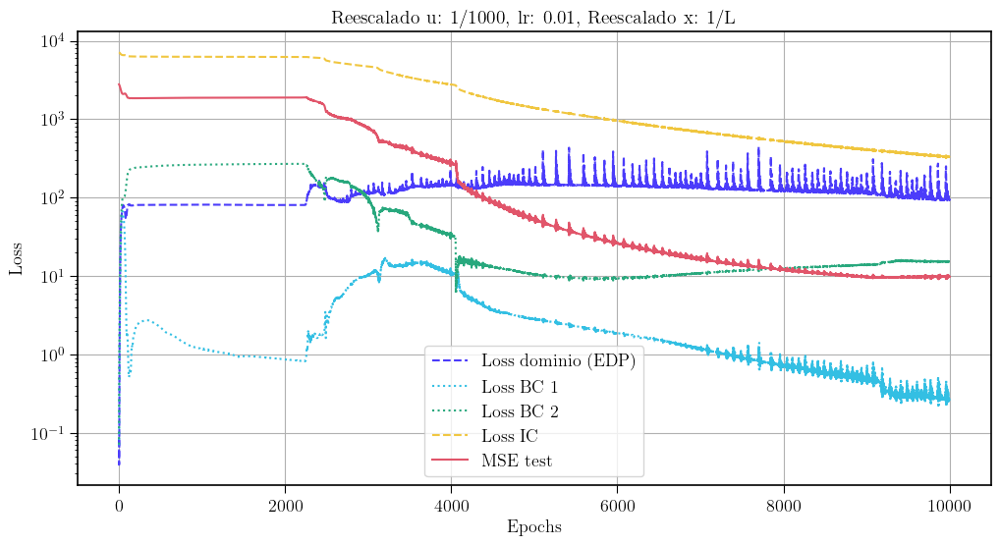

In [79]:
testmetric79 = np.array(losshistory79.metrics_test)*F**2

colors = [
    "#4B3CFA", 
    "#33BFE3", 
    "#28A87D",  
    "#F0C640",  
    "#E1556A", 
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric79[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Reescalado u: 1/1000, lr: 0.01, Reescalado x: 1/L")
plt.legend()
plt.grid(True)
plt.show()

Ahoara con una arquitectura más compleja

In [80]:
F = 1 # Reescalado

In [81]:
# Se reescala la geometría del espacio.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [82]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.DirichletBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    EDPreescaladox,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution= u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"], loss_weights=[2, 1, 1, 4])
# Entrenar el modelo.
model.train(iterations=10000,display_every=1)
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 4])
losshistory1, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.029026 s

'compile' took 0.336130 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.13e-03, 8.45e-04, 8.31e-03, 2.85e+04]    [1.97e-03, 8.45e-04, 8.31e-03, 2.85e+04]    [2.78e+03]    
1         [2.25e+00, 1.92e-01, 3.09e+00, 2.82e+04]    [2.28e+00, 1.92e-01, 3.09e+00, 2.82e+04]    [2.70e+03]    
2         [8.03e+00, 1.07e+00, 1.08e+01, 2.79e+04]    [8.17e+00, 1.07e+00, 1.08e+01, 2.79e+04]    [2.60e+03]    
3         [1.64e+01, 3.84e+00, 2.15e+01, 2.76e+04]    [1.68e+01, 3.84e+00, 2.15e+01, 2.76e+04]    [2.50e+03]    
4         [2.75e+01, 1.01e+01, 3.26e+01, 2.73e+04]    [2.81e+01, 1.01e+01, 3.26e+01, 2.73e+04]    [2.40e+03]    
5         [4.08e+01, 2.05e+01, 4.31e+01, 2.70e+04]    [4.17e+01, 2.05e+01, 4.31e+01, 2.70e+04]    [2.31e+03]    
6         [5.49e+01, 3.38e+01, 5.28e+01, 2.68e+04]    [5.60e+01, 3.38e+01, 5.28

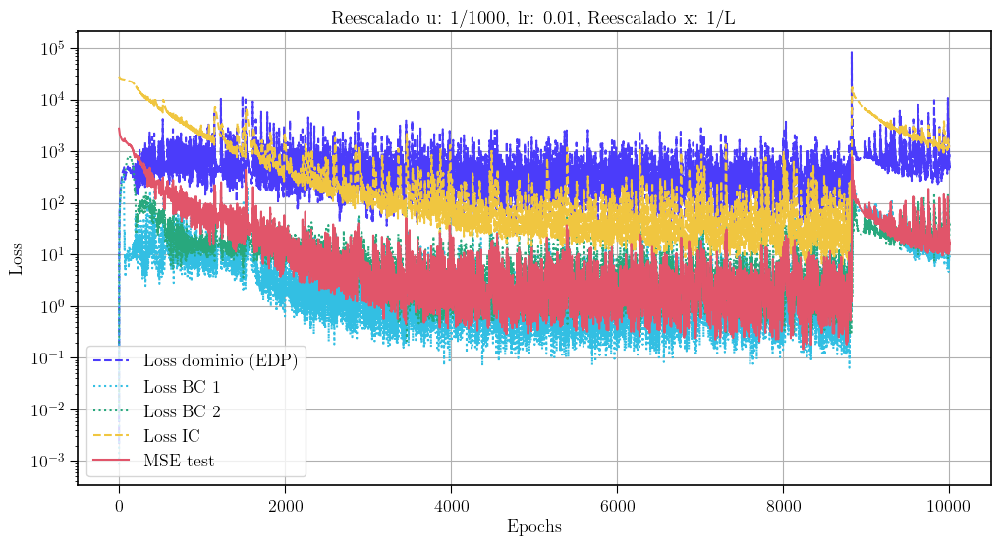

In [83]:
loss_train = np.array(losshistory1.loss_train)*F**2
testmetric4 = np.array(losshistory1.metrics_test)*F**2

colors = [
    "#4B3CFA",  
    "#33BFE3", 
    "#28A87D", 
    "#F0C640", 
    "#E1556A", 
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric4[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Reescalado u: 1/1000, lr: 0.01, Reescalado x: 1/L")
plt.legend()
plt.grid(True)
plt.show()